# Automated Recyclable Detection
 <img src="https://events.palmbeachculture.com/images/organizations/110293918.jpg?v=1515178327" width="250"/>
 

### Detectron2 Installation

In [ ]:
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.6.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# install detectron2: (colab has CUDA 10.1 + torch 1.6)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
assert torch.__version__.startswith("1.6")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html
     |████████████████████████████████| 6.6MB 601kB/s 
     |████████████████████████████████| 2.2MB 12.2MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20201020-cp36-none-any.whl size=44210 sha256=e57467efc30b9f2c8cfdfbade9f3729cbaed32c0f3f3fd18324e2d7eabc4633d
  Stored in directory: /root/.cache/pip/wheels/71/6c/b5/198f89a5c5f127327730248cc623e5a307ad11ed287c3fe391
Successfully built fvcore
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Import some common libraries
%matplotlib inline
import matplotlib.pyplot as plt 
import numpy as np
import os
import cv2
import random
import json
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

### Data preparation 

In [ ]:
%%bash
unzip footage.zip

Archive:  footage.zip
   creating: footage/
  inflating: footage/.DS_Store       
  inflating: __MACOSX/footage/._.DS_Store  
   creating: footage/train/
   creating: footage/val/
  inflating: footage/train/016.jpg   
  inflating: __MACOSX/footage/train/._016.jpg  
  inflating: footage/train/002.jpg   
  inflating: __MACOSX/footage/train/._002.jpg  
  inflating: footage/train/003.jpg   
  inflating: __MACOSX/footage/train/._003.jpg  
  inflating: footage/train/017.jpg   
  inflating: __MACOSX/footage/train/._017.jpg  
  inflating: footage/train/frame5700.jpg  
  inflating: __MACOSX/footage/train/._frame5700.jpg  
  inflating: footage/train/029.jpg   
  inflating: __MACOSX/footage/train/._029.jpg  
  inflating: footage/train/001.jpg   
  inflating: __MACOSX/footage/train/._001.jpg  
  inflating: footage/train/015.jpg   
  inflating: __MACOSX/footage/train/._015.jpg  
  inflating: footage/train/014.jpg   
  inflating: __MACOSX/footage/train/._014.jpg  
  inflating: footage/train/000.jpg 

In [ ]:
from detectron2.structures import BoxMode

def get_recyclable_dicts(img_dir):
    classes = ['non-contamination', 'contamination']
    json_file = os.path.join(img_dir, "via_region_data.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)
        
    dataset_dicts = []
    for idx, v in enumerate(imgs_anns.values()):
        record = {}
        
        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]
        
        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width
      
        annos = v["regions"]
        objs = []
        for _, anno in annos.items():
            ann = anno["shape_attributes"]
            px = ann["all_points_x"]
            py = ann["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]
            
            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                'category_id': classes.index(anno['region_attributes']['type']),
                'iscrowd': 0
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog
for d in ['train', 'val']:
    DatasetCatalog.register('footage_' + d, lambda d=d: get_recyclable_dicts('footage/' + d))
    MetadataCatalog.get('footage_' + d).set(thing_classes=['non-contaimination', 'contaimation'])
recycling_metadata = MetadataCatalog.get('footage_train')

##### Visualization

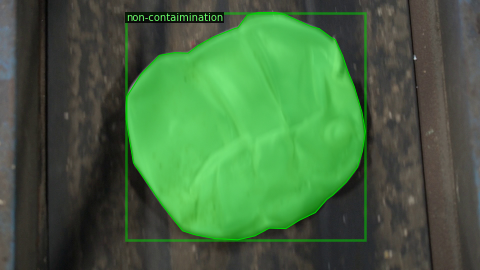

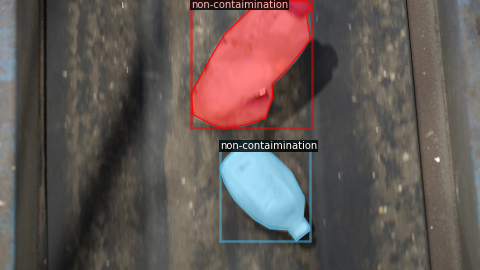

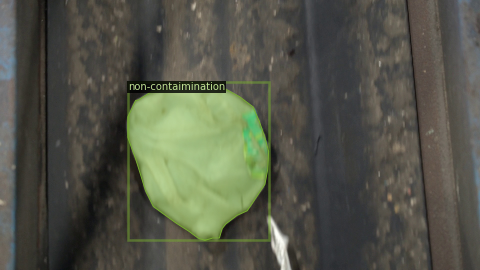

In [ ]:
dataset_dicts = get_recyclable_dicts("footage/train")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d['file_name'])
    visualizer = Visualizer(img[:, :, ::-1], metadata=recycling_metadata, scale=0.25)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Training Loop

In [ ]:
import time
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))
cfg.DATASETS.TRAIN = ('footage_train',)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml')
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
start_time = time.time()
trainer.train()
print("--- %s seconds ---" % (time.time() - start_time))

[10/25 17:33:10 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:08, 21.6MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[10/25 17:33:27 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/layers/wrappers.py:226: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_

[10/25 17:33:38 d2.utils.events]:  eta: 0:09:08  iter: 19  total_loss: 2.080  loss_cls: 1.141  loss_box_reg: 0.247  loss_mask: 0.689  loss_rpn_cls: 0.002  loss_rpn_loc: 0.005  time: 0.5554  data_time: 0.0235  lr: 0.000005  max_mem: 2671M
[10/25 17:33:50 d2.utils.events]:  eta: 0:09:01  iter: 39  total_loss: 1.913  loss_cls: 0.970  loss_box_reg: 0.271  loss_mask: 0.668  loss_rpn_cls: 0.002  loss_rpn_loc: 0.006  time: 0.5613  data_time: 0.0050  lr: 0.000010  max_mem: 2671M
[10/25 17:34:01 d2.utils.events]:  eta: 0:08:51  iter: 59  total_loss: 1.548  loss_cls: 0.684  loss_box_reg: 0.232  loss_mask: 0.622  loss_rpn_cls: 0.002  loss_rpn_loc: 0.005  time: 0.5657  data_time: 0.0057  lr: 0.000015  max_mem: 2671M
[10/25 17:34:13 d2.utils.events]:  eta: 0:08:50  iter: 79  total_loss: 1.286  loss_cls: 0.452  loss_box_reg: 0.270  loss_mask: 0.569  loss_rpn_cls: 0.003  loss_rpn_loc: 0.006  time: 0.5722  data_time: 0.0048  lr: 0.000020  max_mem: 2671M
[10/25 17:34:25 d2.utils.events]:  eta: 0:08:42 

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

### Inference & Evaluation

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 
cfg.DATASETS.TEST = ("recycling_val", )
predictor = DefaultPredictor(cfg)

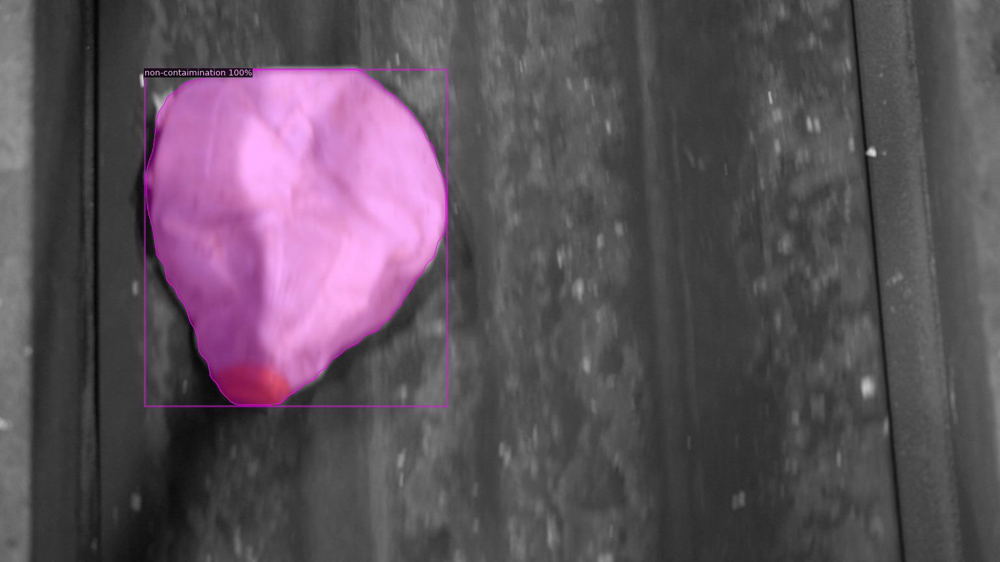

--- 0.7796852588653564 seconds ---


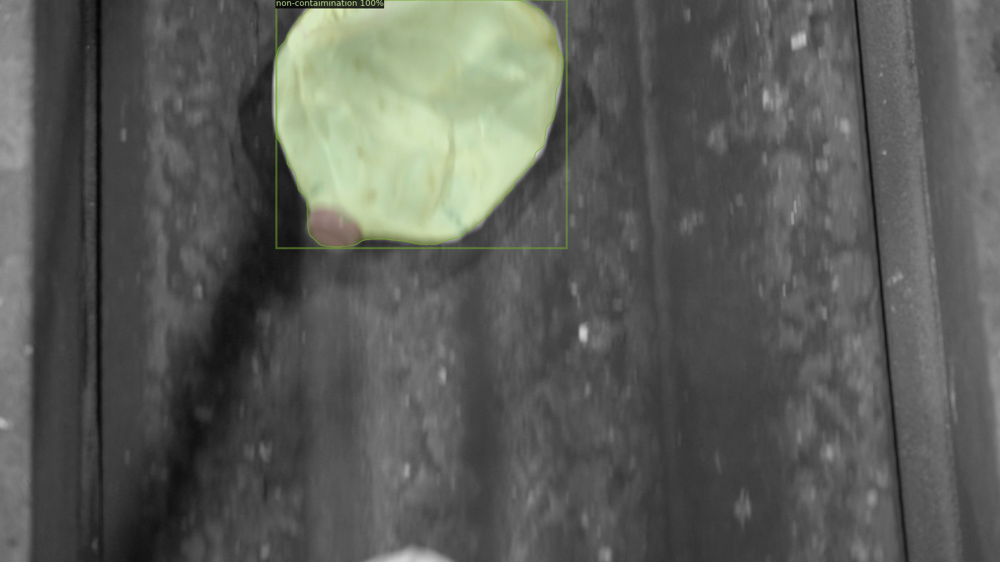

--- 0.7710559368133545 seconds ---


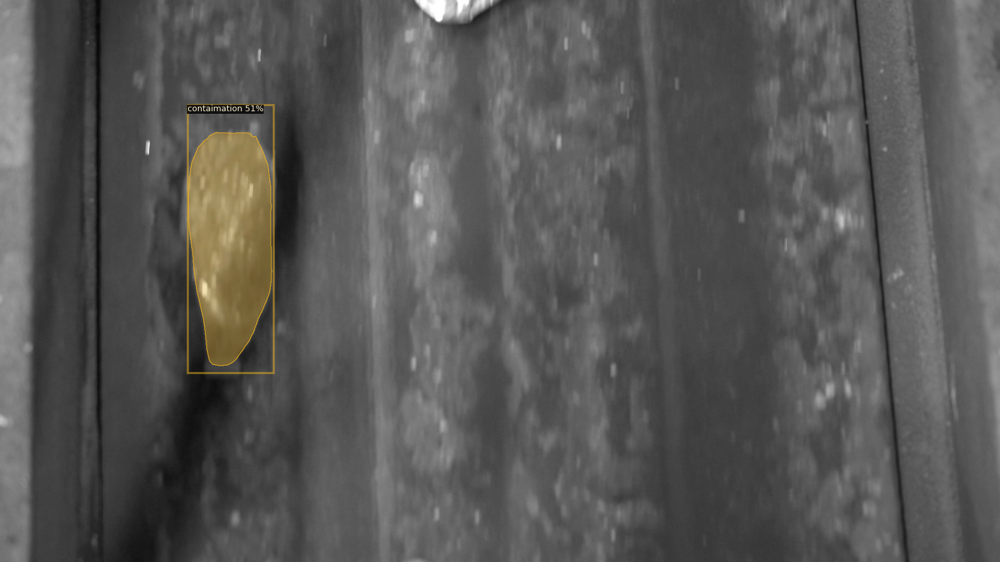

--- 0.7509119510650635 seconds ---


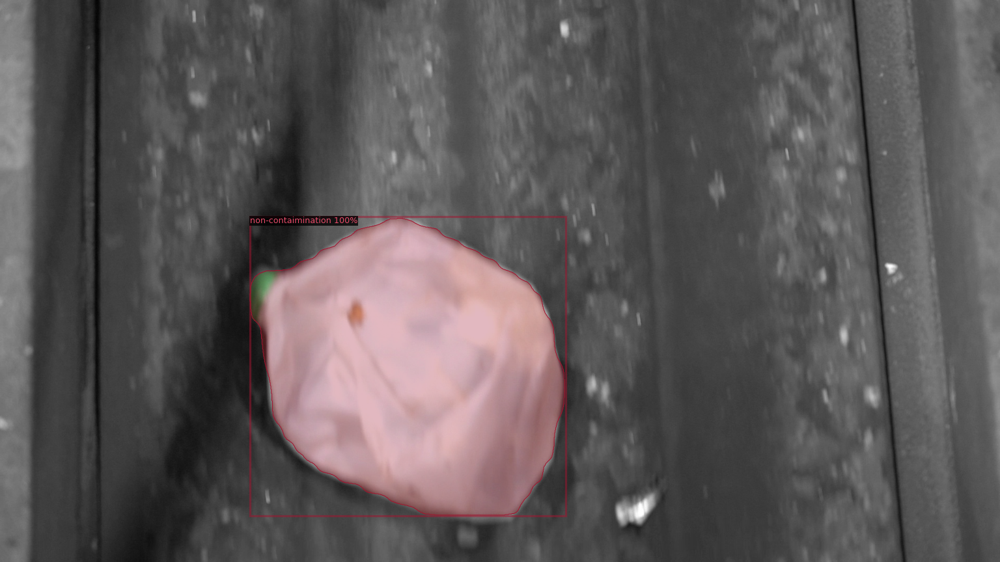

--- 0.8002467155456543 seconds ---


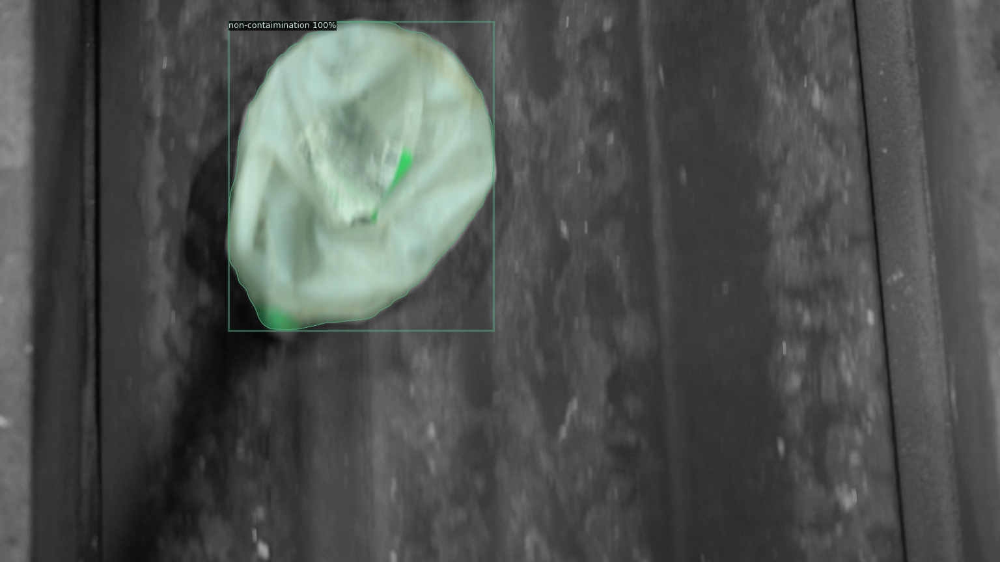

--- 0.8072249889373779 seconds ---


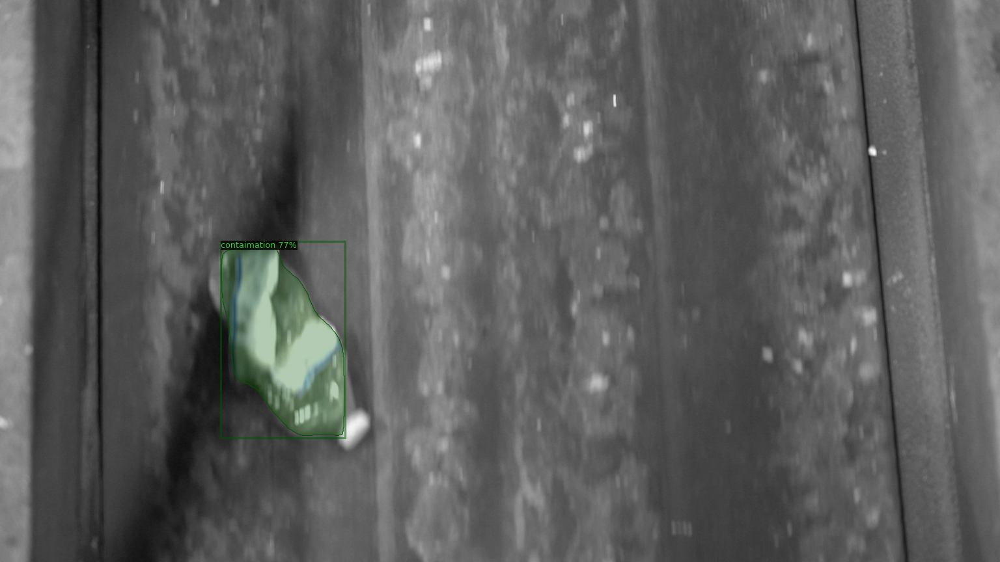

--- 0.7568159103393555 seconds ---


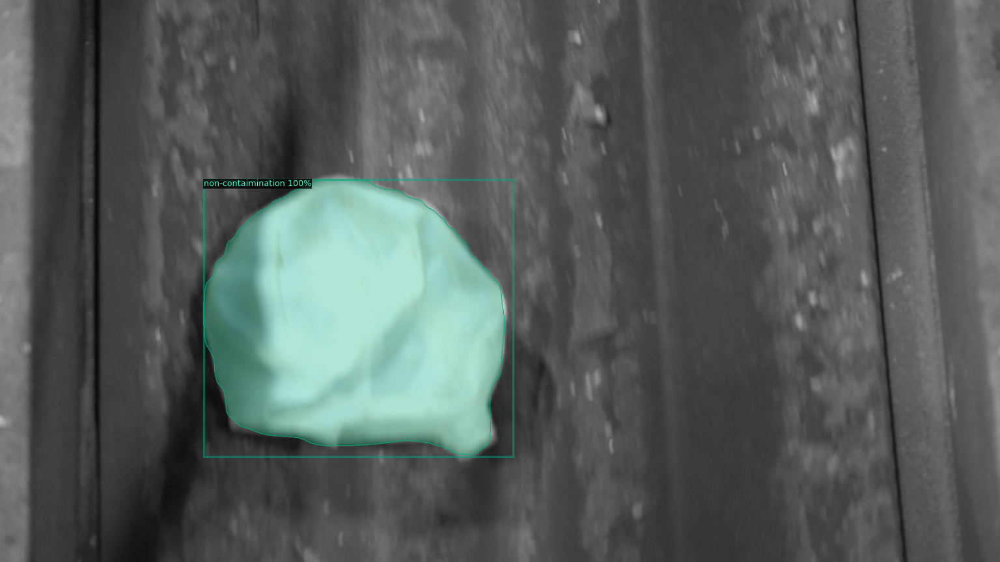

--- 0.778850793838501 seconds ---


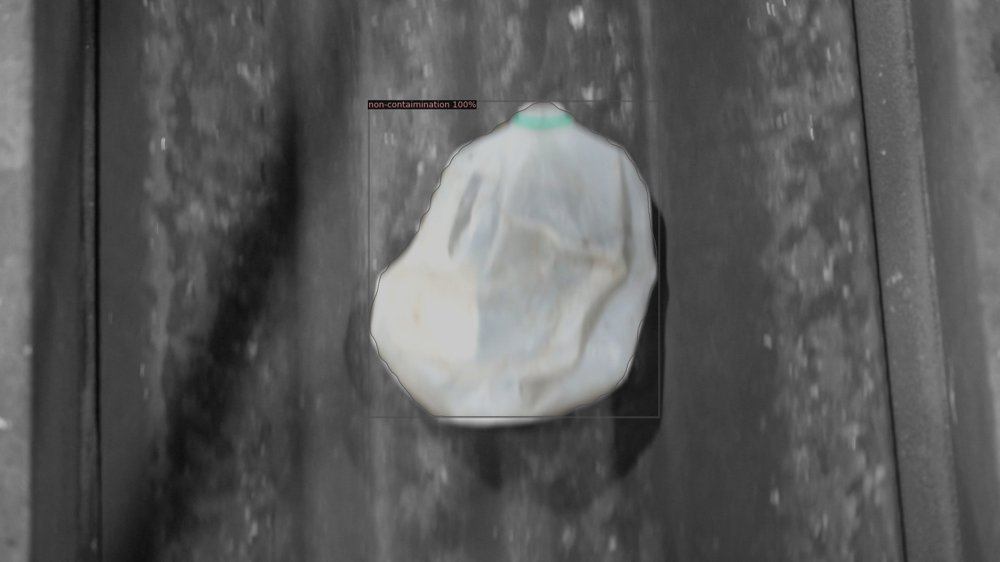

--- 0.7845473289489746 seconds ---


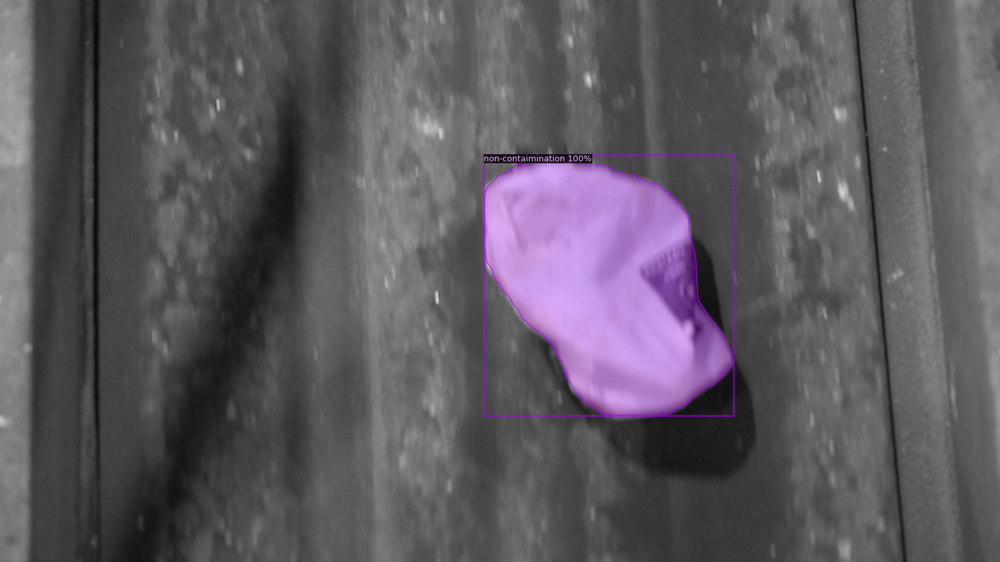

--- 0.7557079792022705 seconds ---


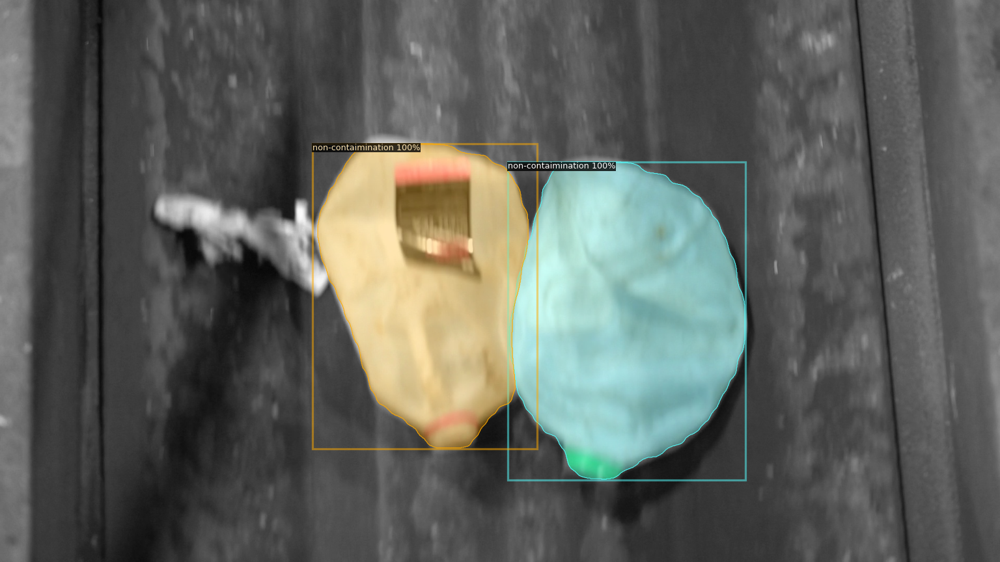

--- 0.8555350303649902 seconds ---


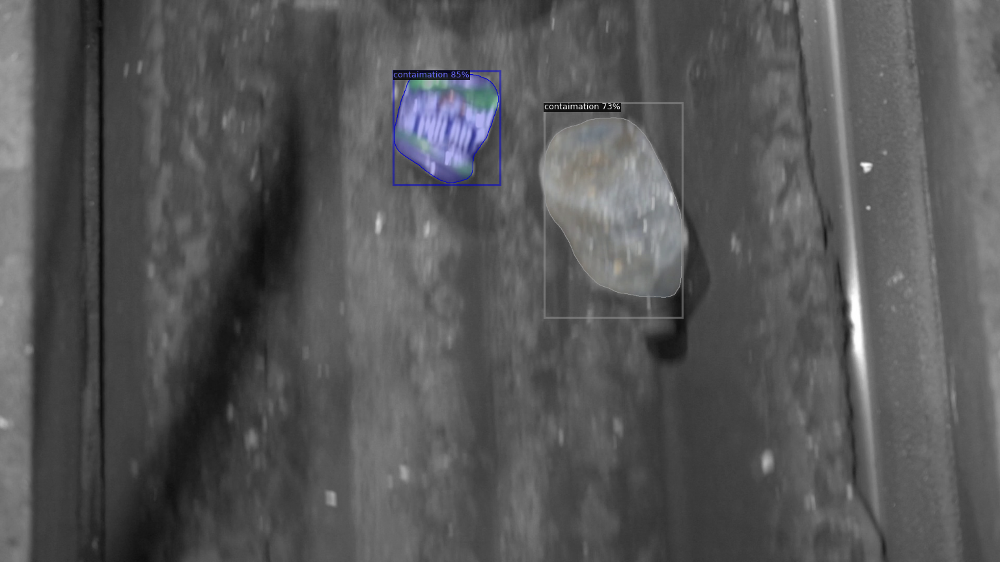

--- 0.7380764484405518 seconds ---


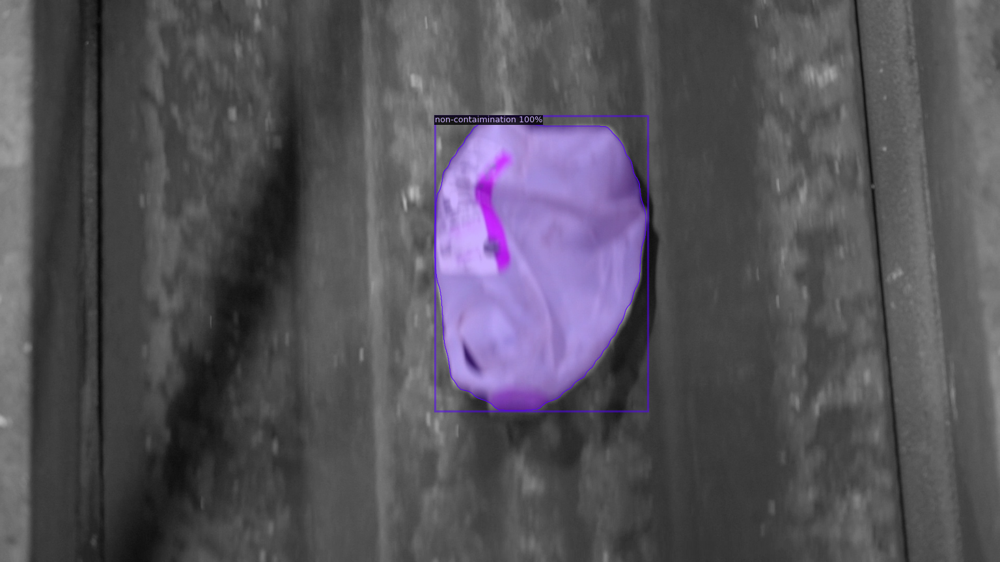

--- 0.8346202373504639 seconds ---


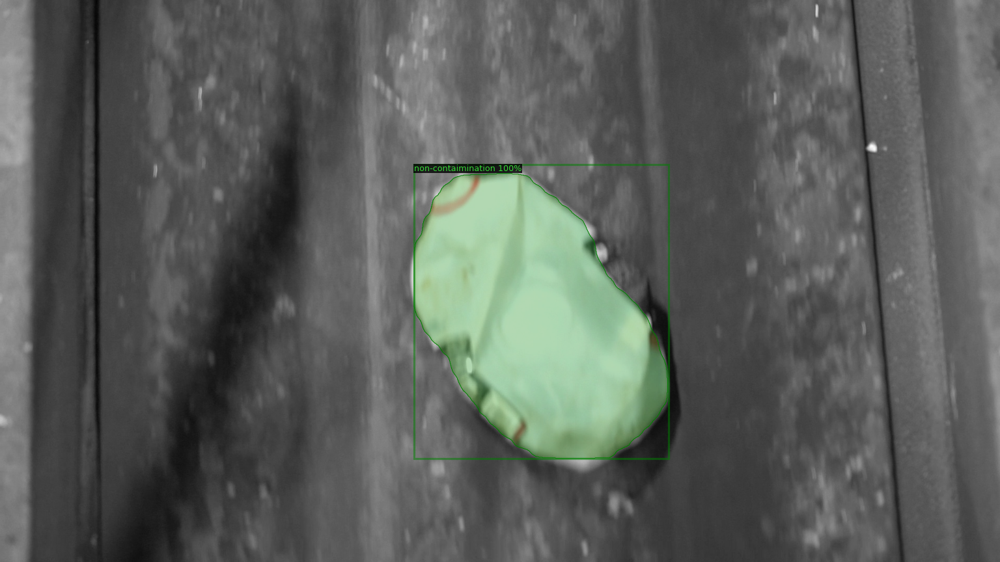

--- 0.759429931640625 seconds ---


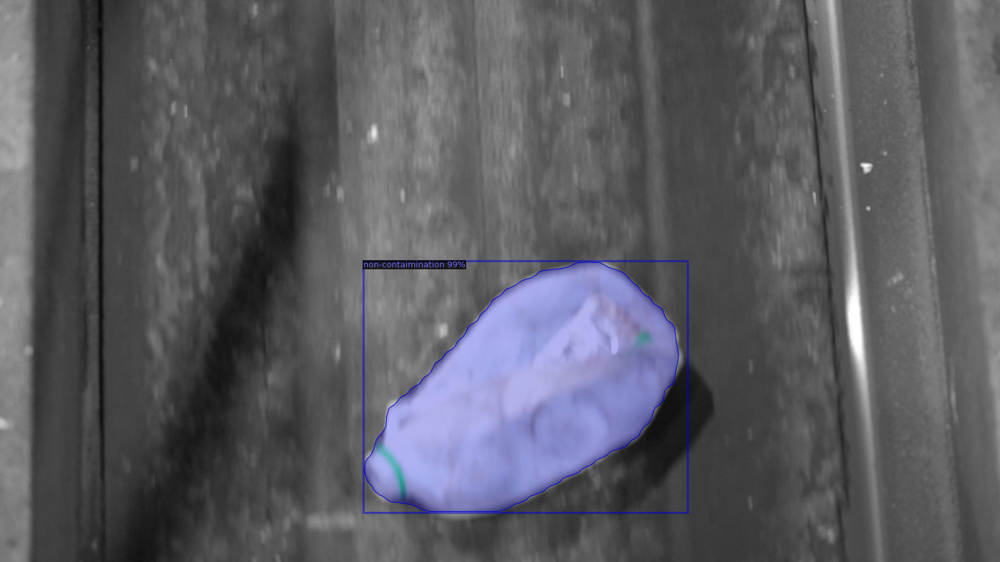

--- 0.7928462028503418 seconds ---


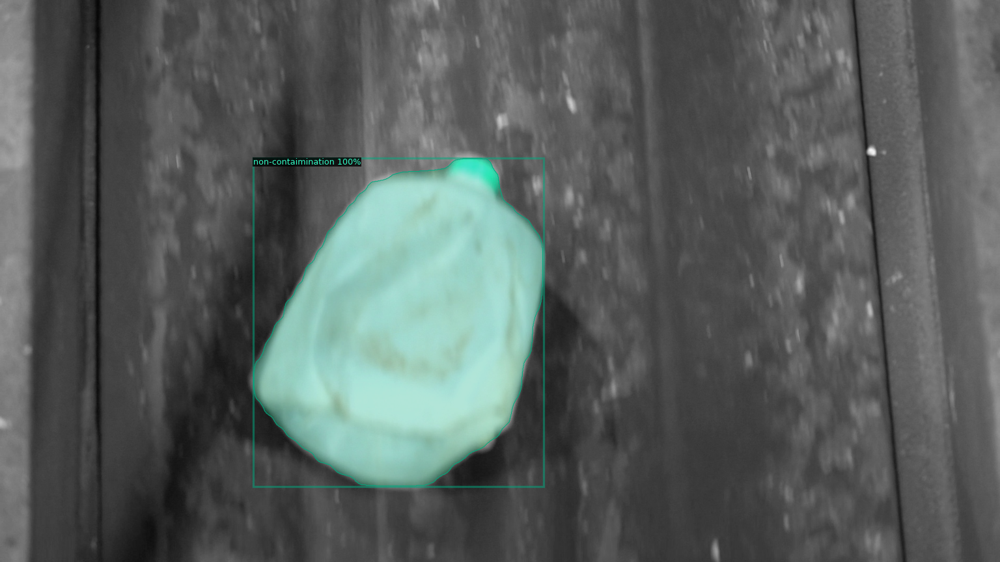

--- 0.7693092823028564 seconds ---


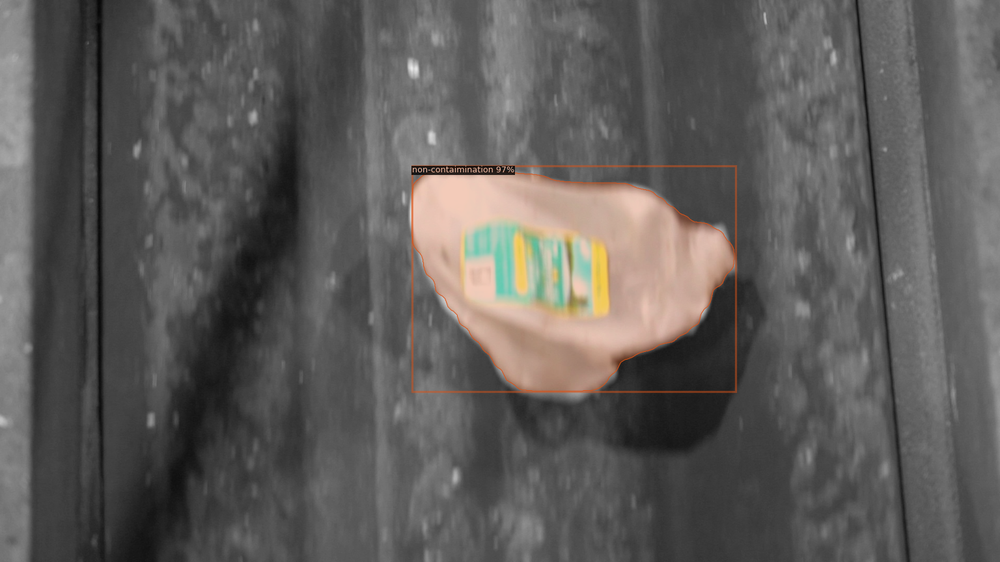

--- 0.7600836753845215 seconds ---


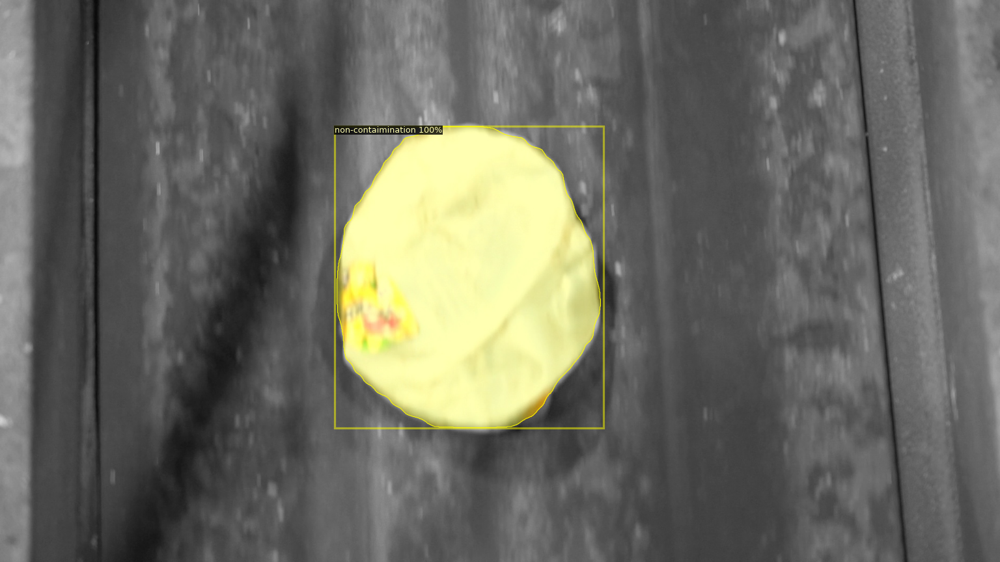

--- 0.9004356861114502 seconds ---


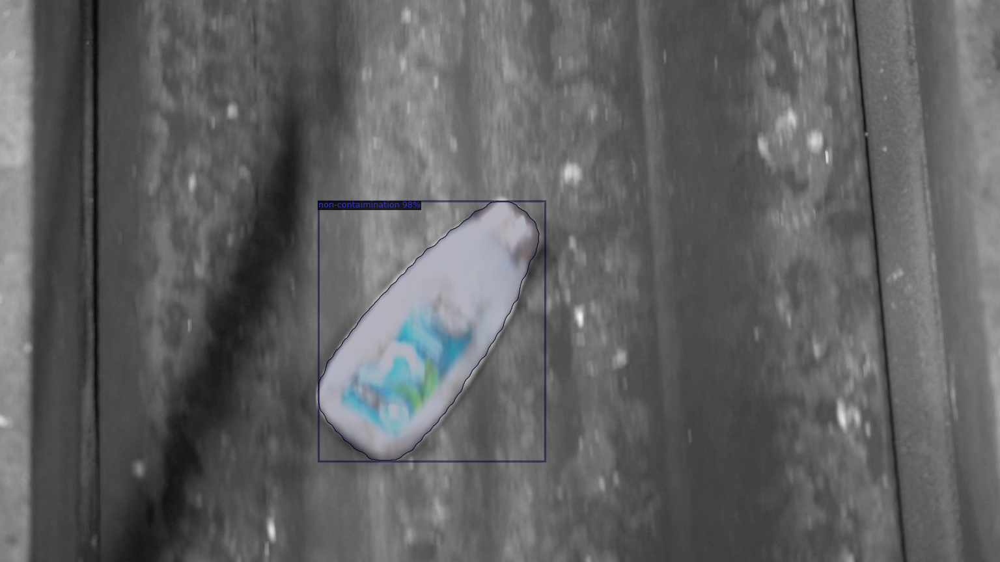

--- 0.7325229644775391 seconds ---


In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_recyclable_dicts("footage/val")
for d in random.sample(dataset_dicts, 18):    
    start_time = time.time()
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=recycling_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])
    loc = "BBOX:\n", outputs["instances"].pred_boxes
    print("--- %s seconds ---" % (time.time() - start_time))

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("footage_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "footage_val")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way is to use trainer.test

[10/25 18:11:55 d2.evaluation.coco_evaluation]: 'footage_val' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
[10/25 18:11:55 d2.data.datasets.coco]: Converting annotations of dataset 'footage_val' to COCO format ...)
[10/25 18:11:55 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[10/25 18:11:55 d2.data.datasets.coco]: Conversion finished, #images: 19, #annotations: 22
[10/25 18:11:55 d2.data.datasets.coco]: Caching COCO format annotations at './output/footage_val_coco_format.json' ...
[10/25 18:11:56 d2.data.build]: Distribution of instances among all 2 categories:
|   category    | #instances   |   category   | #instances   |
|:-------------:|:-------------|:------------:|:-------------|
| non-contaim.. | 18           | contaimation | 4            |
|               |              |              |              |
|     total     | 22           |              |              |
[10/25 18:11:56 d2.data.common]: Serializin

OrderedDict([('bbox',
              {'AP': 76.84041933605124,
               'AP-contaimation': 60.198019801980195,
               'AP-non-contaimination': 93.48281887012232,
               'AP50': 100.0,
               'AP75': 69.05940594059405,
               'APl': 76.84041933605124,
               'APm': nan,
               'APs': nan}),
             ('segm',
              {'AP': 89.74422442244224,
               'AP-contaimation': 81.43564356435643,
               'AP-non-contaimination': 98.05280528052805,
               'AP50': 100.0,
               'AP75': 100.0,
               'APl': 89.74422442244224,
               'APm': nan,
               'APs': nan})])